# Map making with Python!

## Import our libraries

In [1]:
import altair
import requests
import pandas
import geopandas
import json

## Altair Settings (Only for Juptyer Notebook)¶

In [2]:
altair.renderers.enable('notebook')
altair.themes.enable('opaque')

ThemeRegistry.enable('opaque')

## Making Maps

In [3]:
def download_json(url):
    '''Downloads JSON file and Returns JSON'''
    repsonse = requests.get(url)
    return repsonse.json()


def read_json_file(path):
    '''Reads JSON file and Returns JSON'''
    with open(path, 'r') as json_file:
        return json.load(json_file)

In [4]:
# verision 2 of generate_base which now included a title for the map
def generate_base(geojson, title, width=400, height=400):
    '''Generates baselayer of map from altair data'''
    data = altair.Data(values=geojson)
    base = altair.Chart(data, title=title).mark_geoshape(
        stroke='black',  # color of the lines
        strokeWidth=1    # the width of the lines
    ).encode(
    ).properties(
        width=width,       # total width of the map
        height=height       # height of the map
    )
    return base

In [5]:
def generate_choropleth(geojson, color_column, legend_title):
    data = altair.Data(values=geojson)
    choropleth = altair.Chart(data).mark_geoshape(
        fill='lightgray',
        stroke='black'
    ).encode(
        altair.Color(color_column,  # change the color based on this column's values
                  type='quantitative', 
                  scale=altair.Scale(scheme='bluegreen'),
                  title=legend_title)
    )
    return choropleth

In [6]:
# Generate Map Layer with Labels
def generate_labels(geojson, font_size=8, text_column="properties.ANC_ID:O"):
    geodata = altair.Data(values=geojson)
    labels = altair.Chart(geodata).mark_text(baseline='top')\
                                    .properties(
                                        width=400,
                                        height=400)\
                                    .encode(
                                         longitude='properties.centroid_lon:Q',
                                         latitude='properties.centroid_lat:Q',
                                         text=text_column,
                                         size=altair.value(font_size),
                                         opacity=altair.value(1)
                                     )
    return labels

## Mapping Timor

In [7]:
# Read geojson from file
geojson = read_json_file('maps_data/districts_full.geojson')

# Load our GeoJSON into a GeoPandas GeoDataFrame
geodataframe = geopandas.GeoDataFrame.from_features((geojson))
geodataframe.head()

,DISTR,DISTRICT,NEWDISCODE,geometry
0,DISTRITO DE AILEU,AILEU,2,POLYGON ((125.7706527709961 -8.587400436401367...
1,DISTRITO DE AINARO,AINARO,1,POLYGON ((125.6111907958984 -8.938739776611328...
2,DISTRITO DE BAUCAU,BAUCAU,3,POLYGON ((126.1930770874023 -8.573740005493164...
3,DISTRITO DE BOBONARO,BOBONARO,4,POLYGON ((125.0385131835938 -9.033220291137695...
4,DISTRITO DE COVALIMA,COVALIMA,5,POLYGON ((125.0958404541016 -9.201809883117676...


In [8]:
fake_population = [x * 13120 for x in list(range(1,14))]
PCODES = list(range(1,14))
data = {'NEWDISCODE': PCODES, 'fake_population': fake_population}

dataframe = pandas.DataFrame(data)
dataframe.head()

,NEWDISCODE,fake_population
0,1,13120
1,2,26240
2,3,39360
3,4,52480
4,5,65600


In [9]:
#merge our fake population into our geodataframe
geodataframe = geodataframe.merge(dataframe, on='NEWDISCODE', how='inner')
geodataframe.head()

,DISTR,DISTRICT,NEWDISCODE,geometry,fake_population
0,DISTRITO DE AILEU,AILEU,2,POLYGON ((125.7706527709961 -8.587400436401367...,26240
1,DISTRITO DE AINARO,AINARO,1,POLYGON ((125.6111907958984 -8.938739776611328...,13120
2,DISTRITO DE BAUCAU,BAUCAU,3,POLYGON ((126.1930770874023 -8.573740005493164...,39360
3,DISTRITO DE BOBONARO,BOBONARO,4,POLYGON ((125.0385131835938 -9.033220291137695...,52480
4,DISTRITO DE COVALIMA,COVALIMA,5,POLYGON ((125.0958404541016 -9.201809883117676...,65600


In [10]:
## Now we convert our geodataframe back to geojson
geojson = json.loads(geodataframe.to_json())
geojson = geojson['features']

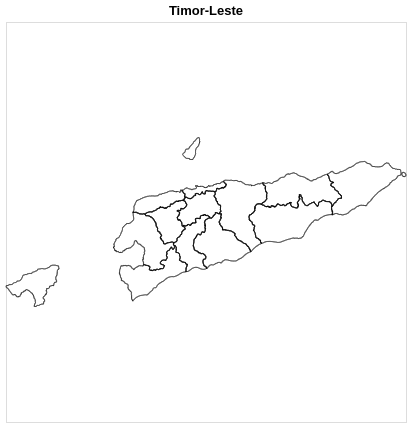

In [11]:
base_layer = generate_base(geojson=geojson, title="Timor-Leste")
base_layer

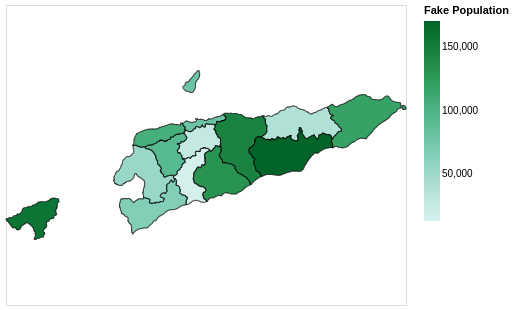

In [12]:
fake_population_map = generate_choropleth(geojson, color_column='properties.fake_population', legend_title="Fake Population")
fake_population_map

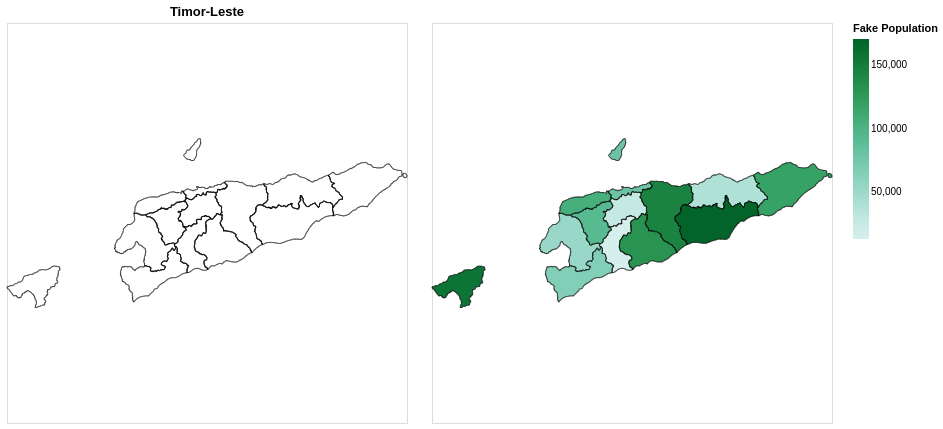

In [13]:
base_layer | fake_population_map 

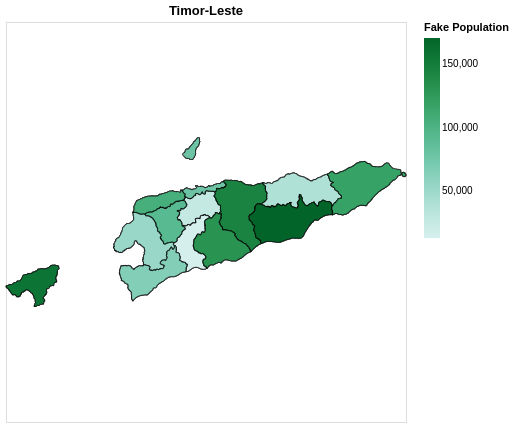

In [14]:
base_layer + fake_population_map 

# Make a Language Map

In [15]:
# Read geojson from file
geojson = read_json_file('maps_data/subdistricts_full.geojson')

# Load our GeoJSON into a GeoPandas GeoDataFrame
geodataframe = geopandas.GeoDataFrame.from_features((geojson))
geodataframe

,NEWSBDCODE,SUBDISTR,Shape_Area,Shape_Leng,geometry
0,201,AILEU VILA,2.576855e-02,0.941802,POLYGON ((125.5118179317913 -8.843150138739759...
1,101,AINARO,1.932222e-02,0.721927,POLYGON ((125.5552215574578 -9.023679733534662...
2,1002,ALAS,3.332919e-02,0.999681,POLYGON ((125.9424285890088 -9.132920265320477...
3,404,ATABAE,2.069081e-02,0.768365,POLYGON ((125.1229934695705 -8.739839553852731...
4,604,ATAURO,1.148134e-02,0.557639,"POLYGON ((125.599487304698 -8.283630371361312,..."
5,704,ATSABE,1.374639e-02,0.661292,POLYGON ((125.3630065921975 -8.869629860207397...
6,304,BAGUIA,1.685993e-02,0.808098,"POLYGON ((126.5880584712697 -8.65412044530285,..."
7,403,BALIBO,2.432415e-02,0.759206,"POLYGON ((125.1110305782195 -8.9638595579907, ..."
8,1105,BARIQUE/NATARBORA,3.253258e-02,1.214973,POLYGON ((126.1007919309473 -8.921719550821763...
9,301,BAUCAU,3.027019e-02,0.804594,POLYGON ((126.3357467655591 -8.451000213881116...


In [19]:
# add the center lat and lon for each shape
geodataframe['centroid_lon'] = geodataframe['geometry'].centroid.x
geodataframe['centroid_lat'] = geodataframe['geometry'].centroid.y
geodataframe.head()

,NEWSBDCODE,SUBDISTR,Shape_Area,Shape_Leng,geometry,centroid_lon,centroid_lat
0,201,AILEU VILA,0.025769,0.941802,POLYGON ((125.5118179317913 -8.843150138739759...,125.557202,-8.748121
1,101,AINARO,0.019322,0.721927,POLYGON ((125.5552215574578 -9.023679733534662...,125.503263,-9.039443
2,1002,ALAS,0.033329,0.999681,POLYGON ((125.9424285890088 -9.132920265320477...,125.837060,-9.049156
3,404,ATABAE,0.020691,0.768365,POLYGON ((125.1229934695705 -8.739839553852731...,125.130863,-8.828478
4,604,ATAURO,0.011481,0.557639,"POLYGON ((125.599487304698 -8.283630371361312,...",125.577550,-8.230297


In [22]:
# make a pandas dataframe from a CSV file containing language data
language_dataframe = pandas.read_csv('maps_data/lian.csv')
language_dataframe

,Mambae (Ainaro),Mambae (Ermera),Tetum,Kemak (Marobo),English,Idate
0,Hato,Hato,Fatuk,Hatu / Atu,Stone / Rock,hatuk
1,Bui,Bui,(refere ba feto),Bui,(femine prefix),bui
2,lico,boe,toba,bue,NaN,bua
3,Tata,Tata,Avo,Tatar,Grandparent,Toko
4,mai,mai(?),visavo,Tatakala,Ancestors,Tokodoro
5,lau,mori,moris,moas,life,mori
6,lau,lau,tutun,laun,top,laun
7,dar,dar,husi,dasa,from,osi
8,huitgau,huitasu,fatuk ahuruin,aturuin,lymestone,hatu-waur
9,gau,gau,ahu,rapo,lyme,waur


In [21]:
# rotate data via pivot table
temp_language_dataframe = language_dataframe.T.reset_index()
temp_language_dataframe[language_dataframe.columns[::-1]]
temp_language_dataframe

KeyError: "Index(['Idate', 'English', 'Kemak (Marobo)', 'Tetum ', 'Mambae (Ermera)',\n       'Mambae (Ainaro)'],\n      dtype='object') not in index"

In [23]:
temp_language_dataframe.head()

,index,0,1,2,3,4,5,6,7,8,...,12,13,14,15,16,17,18,19,20,21
0,Mambae (Ainaro),Hato,Bui,lico,Tata,mai,lau,lau,dar,huitgau,...,aos,Ur,rom,ura,ro,nei,eot,ko,rema,pun rema
1,Mambae (Ermera),Hato,Bui,boe,Tata,mai(?),mori,lau,dar,huitasu,...,kasa,ura,ro,ua,atuba,nei,ko,sgo,man,pun rema
2,Tetum,Fatuk,(refere ba feto),toba,Avo,visavo,moris,tutun,husi,fatuk ahuruin,...,koto,sanan,sira,nia,ema,iha,hare,subar,tetuk,halo tetuk
3,Kemak (Marobo),Hatu / Atu,Bui,bue,Tatar,Tatakala,moas,laun,dasa,aturuin,...,papa,ura,ro / romo,ua,atamas,dia,nae,bobo,reman,taureman
4,English,Stone / Rock,(femine prefix),NaN,Grandparent,Ancestors,life,top,from,lymestone,...,bean,pot,they,he/her,people,have,see,hide,flat,to flatten


In [ ]:
words = temp_language_dataframe[0].tolist()
PCODES = [101, 702, 605, 402, 507, 1106]
data = {'NEWSBDCODE': PCODES, 'words': words}

dataframe = pandas.DataFrame(data)
dataframe

In [211]:
words

['Hato ', 'Hato', 'Fatuk', 'Hatu / Atu', 'Stone / Rock', 'hatuk']

In [212]:
#merge our fake population into our geodataframe
geodataframe = geodataframe.merge(dataframe, on='NEWSBDCODE', how='inner')
geodataframe.head()

,NEWSBDCODE,SUBDISTR,Shape_Area,Shape_Leng,geometry,centroid_lon,centroid_lat,words
0,101,AINARO,0.019322,0.721927,POLYGON ((125.5552215574578 -9.023679733534662...,125.503263,-9.039443,Hato
1,402,CAILACO,0.016795,0.675111,POLYGON ((125.3222122189974 -8.948240280474636...,125.254705,-8.884604,Hatu / Atu
2,605,DOM ALEIXO,0.002709,0.273478,POLYGON ((125.5580596927765 -8.547610283076949...,125.533195,-8.568024,Fatuk
3,702,ERMERA,0.007666,0.492230,POLYGON ((125.4193572993651 -8.810029983487027...,125.415591,-8.758040,Hato
4,1106,LACLUBAR,0.032078,1.193707,POLYGON ((125.8053588868625 -8.745240211066459...,125.907208,-8.745527,hatuk


In [213]:
## Now we convert our geodataframe back to geojson and pass it to altair.Data
geojson = json.loads(geodataframe.to_json())
geojson = geojson['features']

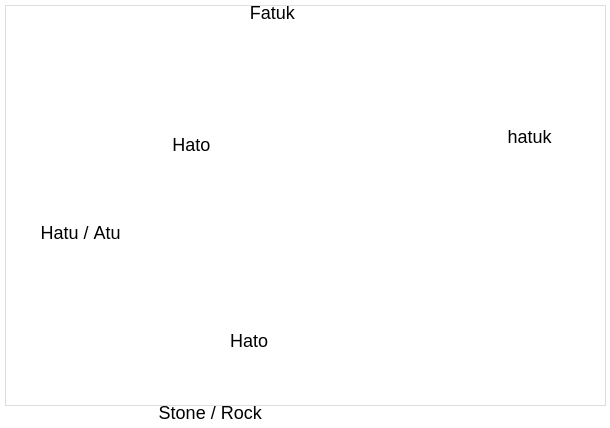

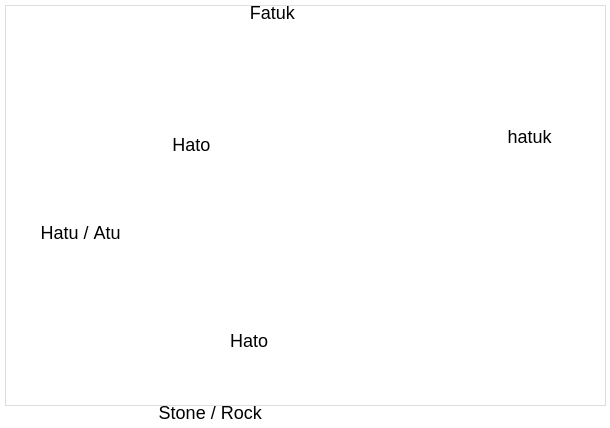

In [216]:
labels_map = generate_labels(geojson, font_size=18, text_column="properties.words:O")
labels_map

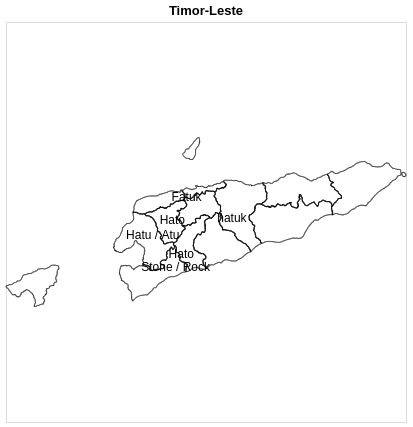

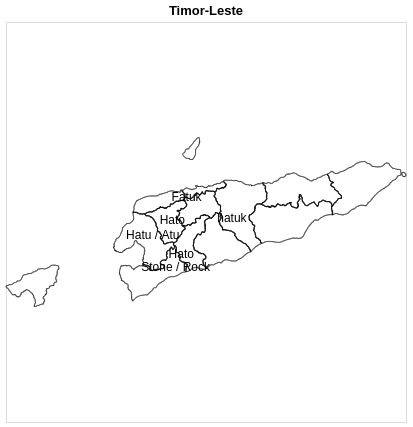

In [215]:
base_layer + labels_map